In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%tensorflow_version 1.x
import tensorflow as tf
%cd "/content/drive/My Drive/stylegan"
!nvcc test_nvcc.cu -o test_nvcc -run

print('Tensorflow version: {}'.format(tf.__version__) )
!nvidia-smi -L
print('GPU Identified at: {}'.format(tf.test.gpu_device_name()))

TensorFlow 1.x selected.
/content/drive/My Drive/stylegan
CPU says hello.
GPU says hello.
Tensorflow version: 1.15.2
GPU 0: Tesla P100-PCIE-16GB (UUID: GPU-5fbf0c57-6ed4-b7e6-45dc-99a5d7257013)
GPU Identified at: /device:GPU:0


In [ ]:
import numpy as np
import tensorflow as tf
import dnnlib
import dnnlib.tflib as tflib
from dnnlib.tflib.autosummary import autosummary

from training import dataset

In [ ]:
import argparse
import numpy as np
import PIL.Image
import dnnlib
import dnnlib.tflib as tflib
import re
import sys
from io import BytesIO
import IPython.display
import numpy as np
from math import ceil
from PIL import Image, ImageDraw
import imageio
import pretrained_networks

###### Training with lazy-regularization and improved batch size, but since training was talking quiet a lot of time on a google colab running on P100(9 hrs 18 mins), we decided to train for 100 k-images only for implementation prospective on google colab we can thereafter use our pretrained model as trained on AWS with p2.xlarge VM instance for generating the interpolrations.

###### Training code taken from the official implementation of style GAN v2(Nvidia Labs)

In [ ]:
# Copyright (c) 2019, NVIDIA Corporation. All rights reserved.
#
# This work is made available under the Nvidia Source Code License-NC.
# To view a copy of this license, visit
# https://nvlabs.github.io/stylegan2/license.html
"""Main training script."""

import numpy as np
import tensorflow as tf
import dnnlib
import dnnlib.tflib as tflib
from dnnlib.tflib.autosummary import autosummary

from training import dataset
from training import misc
from metrics import metric_base

#----------------------------------------------------------------------------
# Just-in-time processing of training images before feeding them to the networks.

def process_reals(x, labels, lod, mirror_augment, drange_data, drange_net):
    with tf.name_scope('DynamicRange'):
        x = tf.cast(x, tf.float32)
        x = misc.adjust_dynamic_range(x, drange_data, drange_net)
    if mirror_augment:
        with tf.name_scope('MirrorAugment'):
            x = tf.where(tf.random_uniform([tf.shape(x)[0]]) < 0.5, x, tf.reverse(x, [3]))
    with tf.name_scope('FadeLOD'): # Smooth crossfade between consecutive levels-of-detail.
        s = tf.shape(x)
        y = tf.reshape(x, [-1, s[1], s[2]//2, 2, s[3]//2, 2])
        y = tf.reduce_mean(y, axis=[3, 5], keepdims=True)
        y = tf.tile(y, [1, 1, 1, 2, 1, 2])
        y = tf.reshape(y, [-1, s[1], s[2], s[3]])
        x = tflib.lerp(x, y, lod - tf.floor(lod))
    with tf.name_scope('UpscaleLOD'): # Upscale to match the expected input/output size of the networks.
        s = tf.shape(x)
        factor = tf.cast(2 ** tf.floor(lod), tf.int32)
        x = tf.reshape(x, [-1, s[1], s[2], 1, s[3], 1])
        x = tf.tile(x, [1, 1, 1, factor, 1, factor])
        x = tf.reshape(x, [-1, s[1], s[2] * factor, s[3] * factor])
    return x, labels

#----------------------------------------------------------------------------
# Evaluate time-varying training parameters.

def training_schedule(
    cur_nimg,
    training_set,
    lod_initial_resolution  = None,     # Image resolution used at the beginning.
    lod_training_kimg       = 600,      # Thousands of real images to show before doubling the resolution.
    lod_transition_kimg     = 600,      # Thousands of real images to show when fading in new layers.
    minibatch_size_base     = 32,       # Global minibatch size.
    minibatch_size_dict     = {},       # Resolution-specific overrides.
    minibatch_gpu_base      = 4,        # Number of samples processed at a time by one GPU.
    minibatch_gpu_dict      = {},       # Resolution-specific overrides.
    G_lrate_base            = 0.002,    # Learning rate for the generator.
    G_lrate_dict            = {},       # Resolution-specific overrides.
    D_lrate_base            = 0.002,    # Learning rate for the discriminator.
    D_lrate_dict            = {},       # Resolution-specific overrides.
    lrate_rampup_kimg       = 0,        # Duration of learning rate ramp-up.
    tick_kimg_base          = 2,        # Default interval of progress snapshots.
    tick_kimg_dict          = {8:28, 16:24, 32:20, 64:16, 128:12, 256:8, 512:6, 1024:4}): # Resolution-specific overrides.

    # Initialize result dict.
    s = dnnlib.EasyDict()
    s.kimg = cur_nimg / 1000.0

    # Training phase.
    phase_dur = lod_training_kimg + lod_transition_kimg
    phase_idx = int(np.floor(s.kimg / phase_dur)) if phase_dur > 0 else 0
    phase_kimg = s.kimg - phase_idx * phase_dur

    # Level-of-detail and resolution.
    if lod_initial_resolution is None:
        s.lod = 0.0
    else:
        s.lod = training_set.resolution_log2
        s.lod -= np.floor(np.log2(lod_initial_resolution))
        s.lod -= phase_idx
        if lod_transition_kimg > 0:
            s.lod -= max(phase_kimg - lod_training_kimg, 0.0) / lod_transition_kimg
        s.lod = max(s.lod, 0.0)
    s.resolution = 2 ** (training_set.resolution_log2 - int(np.floor(s.lod)))

    # Minibatch size.
    s.minibatch_size = minibatch_size_dict.get(s.resolution, minibatch_size_base)
    s.minibatch_gpu = minibatch_gpu_dict.get(s.resolution, minibatch_gpu_base)

    # Learning rate.
    s.G_lrate = G_lrate_dict.get(s.resolution, G_lrate_base)
    s.D_lrate = D_lrate_dict.get(s.resolution, D_lrate_base)
    if lrate_rampup_kimg > 0:
        rampup = min(s.kimg / lrate_rampup_kimg, 1.0)
        s.G_lrate *= rampup
        s.D_lrate *= rampup

    # Other parameters.
    s.tick_kimg = tick_kimg_dict.get(s.resolution, tick_kimg_base)
    return s

#----------------------------------------------------------------------------
# Main training script.

def training_loop(
    G_args                  = {},       # Options for generator network.
    D_args                  = {},       # Options for discriminator network.
    G_opt_args              = {},       # Options for generator optimizer.
    D_opt_args              = {},       # Options for discriminator optimizer.
    G_loss_args             = {},       # Options for generator loss.
    D_loss_args             = {},       # Options for discriminator loss.
    dataset_args            = {},       # Options for dataset.load_dataset().
    sched_args              = {},       # Options for train.TrainingSchedule.
    grid_args               = {},       # Options for train.setup_snapshot_image_grid().
    metric_arg_list         = [],       # Options for MetricGroup.
    tf_config               = {},       # Options for tflib.init_tf().
    data_dir                = "Enter your Path to Dataset Dir here",     # Directory to load datasets from.
    G_smoothing_kimg        = 10.0,     # Half-life of the running average of generator weights.
    minibatch_repeats       = 4,        # Number of minibatches to run before adjusting training parameters.
    lazy_regularization     = True,     # Perform regularization as a separate training step?
    G_reg_interval          = 4,        # How often the perform regularization for G? Ignored if lazy_regularization=False.
    D_reg_interval          = 16,       # How often the perform regularization for D? Ignored if lazy_regularization=False.
    reset_opt_for_new_lod   = True,     # Reset optimizer internal state (e.g. Adam moments) when new layers are introduced?
    total_kimg              = 10000,    # Total length of the training, measured in thousands of real images.
    mirror_augment          = False,    # Enable mirror augment?
    drange_net              = [-1,1],   # Dynamic range used when feeding image data to the networks.
    image_snapshot_ticks    = 50,       # How often to save image snapshots? None = only save 'reals.png' and 'fakes-init.png'.
    network_snapshot_ticks  = 50,       # How often to save network snapshots? None = only save 'networks-final.pkl'.
    save_tf_graph           = True,    # Include full TensorFlow computation graph in the tfevents file?
    save_weight_histograms  = False,    # Include weight histograms in the tfevents file?
    # resume_pkl              = './networks/stylegan2-ffhq-config-f.pkl',     # Network pickle to resume training from, None = train from scratch.
    resume_pkl              = 'latest',
    resume_kimg             = 10000.0,      # Assumed training progress at the beginning. Affects reporting and training schedule.
    resume_time             = 0.0,      # Assumed wallclock time at the beginning. Affects reporting.
    resume_with_new_nets    = False
    kimages = 100):   # Construct new networks according to G_args and D_args before resuming training?

    # Initialize dnnlib and TensorFlow.
    tflib.init_tf(tf_config)
    num_gpus = dnnlib.submit_config.num_gpus

    # Load training set.
    training_set = dataset.load_dataset(data_dir=dnnlib.convert_path(data_dir), verbose=True, **dataset_args)
    grid_size, grid_reals, grid_labels = misc.setup_snapshot_image_grid(training_set, **grid_args)
    misc.save_image_grid(grid_reals, dnnlib.make_run_dir_path('reals.jpg'), drange=training_set.dynamic_range, grid_size=grid_size)

    # Construct or load networks.
    with tf.device('/gpu:0'):
        if resume_pkl == 'latest':
           resume_pkl, resume_kimg = misc.locate_latest_pkl(dnnlib.submit_config.run_dir_root)
        if resume_pkl is None or resume_with_new_nets:
            print('Constructing networks...')
            G = tflib.Network('G', num_channels=training_set.shape[0], resolution=training_set.shape[1], label_size=training_set.label_size, **G_args)
            D = tflib.Network('D', num_channels=training_set.shape[0], resolution=training_set.shape[1], label_size=training_set.label_size, **D_args)
            Gs = G.clone('Gs')
        if resume_pkl is not None:
            print('Loading networks from "%s"...' % resume_pkl)
            rG, rD, rGs = misc.load_pkl(resume_pkl)
            if resume_with_new_nets: G.copy_vars_from(rG); D.copy_vars_from(rD); Gs.copy_vars_from(rGs)
            else: G = rG; D = rD; Gs = rGs

    # Print layers and generate initial image snapshot.
    G.print_layers(); D.print_layers()
    sched = training_schedule(cur_nimg=total_kimg*1000, training_set=training_set, **sched_args)
    grid_latents = np.random.randn(np.prod(grid_size), *G.input_shape[1:])
    grid_fakes = Gs.run(grid_latents, grid_labels, is_validation=True, minibatch_size=sched.minibatch_gpu)
    misc.save_image_grid(grid_fakes, dnnlib.make_run_dir_path('fakes_init.jpg'), drange=drange_net, grid_size=grid_size)

    # Setup training inputs.
    print('Building TensorFlow graph...')
    with tf.name_scope('Inputs'), tf.device('/cpu:0'):
        lod_in               = tf.placeholder(tf.float32, name='lod_in', shape=[])
        lrate_in             = tf.placeholder(tf.float32, name='lrate_in', shape=[])
        minibatch_size_in    = tf.placeholder(tf.int32, name='minibatch_size_in', shape=[])
        minibatch_gpu_in     = tf.placeholder(tf.int32, name='minibatch_gpu_in', shape=[])
        minibatch_multiplier = minibatch_size_in // (minibatch_gpu_in * num_gpus)
        Gs_beta              = 0.5 ** tf.div(tf.cast(minibatch_size_in, tf.float32), G_smoothing_kimg * 1000.0) if G_smoothing_kimg > 0.0 else 0.0

    # Setup optimizers.
    G_opt_args = dict(G_opt_args)
    D_opt_args = dict(D_opt_args)
    for args, reg_interval in [(G_opt_args, G_reg_interval), (D_opt_args, D_reg_interval)]:
        args['minibatch_multiplier'] = minibatch_multiplier
        args['learning_rate'] = lrate_in
        if lazy_regularization:
            mb_ratio = reg_interval / (reg_interval + 1)
            args['learning_rate'] *= mb_ratio
            if 'beta1' in args: args['beta1'] **= mb_ratio
            if 'beta2' in args: args['beta2'] **= mb_ratio
    G_opt = tflib.Optimizer(name='TrainG', **G_opt_args)
    D_opt = tflib.Optimizer(name='TrainD', **D_opt_args)
    G_reg_opt = tflib.Optimizer(name='RegG', share=G_opt, **G_opt_args)
    D_reg_opt = tflib.Optimizer(name='RegD', share=D_opt, **D_opt_args)

    # Build training graph for each GPU.
    data_fetch_ops = []
    for gpu in range(num_gpus):
        with tf.name_scope('GPU%d' % gpu), tf.device('/gpu:%d' % gpu):

            # Create GPU-specific shadow copies of G and D.
            G_gpu = G if gpu == 0 else G.clone(G.name + '_shadow')
            D_gpu = D if gpu == 0 else D.clone(D.name + '_shadow')

            # Fetch training data via temporary variables.
            with tf.name_scope('DataFetch'):
                sched = training_schedule(cur_nimg=int(resume_kimg*1000), training_set=training_set, **sched_args)
                reals_var = tf.Variable(name='reals', trainable=False, initial_value=tf.zeros([sched.minibatch_gpu] + training_set.shape))
                labels_var = tf.Variable(name='labels', trainable=False, initial_value=tf.zeros([sched.minibatch_gpu, training_set.label_size]))
                reals_write, labels_write = training_set.get_minibatch_tf()
                reals_write, labels_write = process_reals(reals_write, labels_write, lod_in, mirror_augment, training_set.dynamic_range, drange_net)
                reals_write = tf.concat([reals_write, reals_var[minibatch_gpu_in:]], axis=0)
                labels_write = tf.concat([labels_write, labels_var[minibatch_gpu_in:]], axis=0)
                data_fetch_ops += [tf.assign(reals_var, reals_write)]
                data_fetch_ops += [tf.assign(labels_var, labels_write)]
                reals_read = reals_var[:minibatch_gpu_in]
                labels_read = labels_var[:minibatch_gpu_in]

            # Evaluate loss functions.
            lod_assign_ops = []
            if 'lod' in G_gpu.vars: lod_assign_ops += [tf.assign(G_gpu.vars['lod'], lod_in)]
            if 'lod' in D_gpu.vars: lod_assign_ops += [tf.assign(D_gpu.vars['lod'], lod_in)]
            with tf.control_dependencies(lod_assign_ops):
                with tf.name_scope('G_loss'):
                    G_loss, G_reg = dnnlib.util.call_func_by_name(G=G_gpu, D=D_gpu, opt=G_opt, training_set=training_set, minibatch_size=minibatch_gpu_in, **G_loss_args)
                with tf.name_scope('D_loss'):
                    D_loss, D_reg = dnnlib.util.call_func_by_name(G=G_gpu, D=D_gpu, opt=D_opt, training_set=training_set, minibatch_size=minibatch_gpu_in, reals=reals_read, labels=labels_read, **D_loss_args)

            # Register gradients.
            if not lazy_regularization:
                if G_reg is not None: G_loss += G_reg
                if D_reg is not None: D_loss += D_reg
            else:
                if G_reg is not None: G_reg_opt.register_gradients(tf.reduce_mean(G_reg * G_reg_interval), G_gpu.trainables)
                if D_reg is not None: D_reg_opt.register_gradients(tf.reduce_mean(D_reg * D_reg_interval), D_gpu.trainables)
            G_opt.register_gradients(tf.reduce_mean(G_loss), G_gpu.trainables)
            D_opt.register_gradients(tf.reduce_mean(D_loss), D_gpu.trainables)

    # Setup training ops.
    data_fetch_op = tf.group(*data_fetch_ops)
    G_train_op = G_opt.apply_updates()
    D_train_op = D_opt.apply_updates()
    G_reg_op = G_reg_opt.apply_updates(allow_no_op=True)
    D_reg_op = D_reg_opt.apply_updates(allow_no_op=True)
    Gs_update_op = Gs.setup_as_moving_average_of(G, beta=Gs_beta)

    # Finalize graph.
    with tf.device('/gpu:0'):
        try:
            peak_gpu_mem_op = tf.contrib.memory_stats.MaxBytesInUse()
        except tf.errors.NotFoundError:
            peak_gpu_mem_op = tf.constant(0)
    tflib.init_uninitialized_vars()

    print('Initializing logs...')
    summary_log = tf.summary.FileWriter(dnnlib.make_run_dir_path())
    if save_tf_graph:
        summary_log.add_graph(tf.get_default_graph())
    if save_weight_histograms:
        G.setup_weight_histograms(); D.setup_weight_histograms()
    metrics = metric_base.MetricGroup(metric_arg_list)

    print('Training for %d kimg...\n' % total_kimg)
    dnnlib.RunContext.get().update('', cur_epoch=resume_kimg, max_epoch=total_kimg)
    maintenance_time = dnnlib.RunContext.get().get_last_update_interval()
    cur_nimg = int(resume_kimg * 1000)
    cur_tick = -1
    tick_start_nimg = cur_nimg
    prev_lod = -1.0
    running_mb_counter = 0
    while cur_nimg < total_kimg * 1000:
        if dnnlib.RunContext.get().should_stop(): break

        # Choose training parameters and configure training ops.
        sched = training_schedule(cur_nimg=cur_nimg, training_set=training_set, **sched_args)
        assert sched.minibatch_size % (sched.minibatch_gpu * num_gpus) == 0
        training_set.configure(sched.minibatch_gpu, sched.lod)
        if reset_opt_for_new_lod:
            if np.floor(sched.lod) != np.floor(prev_lod) or np.ceil(sched.lod) != np.ceil(prev_lod):
                G_opt.reset_optimizer_state(); D_opt.reset_optimizer_state()
        prev_lod = sched.lod

        # Run training ops.
        feed_dict = {lod_in: sched.lod, lrate_in: sched.G_lrate, minibatch_size_in: sched.minibatch_size, minibatch_gpu_in: sched.minibatch_gpu}
        for _repeat in range(minibatch_repeats):
            rounds = range(0, sched.minibatch_size, sched.minibatch_gpu * num_gpus)
            run_G_reg = (lazy_regularization and running_mb_counter % G_reg_interval == 0)
            run_D_reg = (lazy_regularization and running_mb_counter % D_reg_interval == 0)
            cur_nimg += sched.minibatch_size
            running_mb_counter += 1

            # Fast path without gradient accumulation.
            if len(rounds) == 1:
                tflib.run([G_train_op, data_fetch_op], feed_dict)
                if run_G_reg:
                    tflib.run(G_reg_op, feed_dict)
                tflib.run([D_train_op, Gs_update_op], feed_dict)
                if run_D_reg:
                    tflib.run(D_reg_op, feed_dict)

            # Slow path with gradient accumulation.
            else:
                for _round in rounds:
                    tflib.run(G_train_op, feed_dict)
                if run_G_reg:
                    for _round in rounds:
                        tflib.run(G_reg_op, feed_dict)
                tflib.run(Gs_update_op, feed_dict)
                for _round in rounds:
                    tflib.run(data_fetch_op, feed_dict)
                    tflib.run(D_train_op, feed_dict)
                if run_D_reg:
                    for _round in rounds:
                        tflib.run(D_reg_op, feed_dict)

        # Perform maintenance tasks once per tick.
        done = (cur_nimg >= total_kimg * 1000)
        # print(cur_nimg, tick_start_nimg + sched.tick_kimg * 1000)
        if cur_tick < 0 or cur_nimg >= tick_start_nimg + sched.tick_kimg * 1000 or done:
            cur_tick += 1
            tick_kimg = (cur_nimg - tick_start_nimg) / 1000.0
            tick_start_nimg = cur_nimg
            tick_time = dnnlib.RunContext.get().get_time_since_last_update()
            total_time = dnnlib.RunContext.get().get_time_since_start() + resume_time

            # Report progress.
            print('tick %-5d kimg %-8.1f lod %-5.2f minibatch %-4d time %-12s sec/tick %-7.1f sec/kimg %-7.2f maintenance %-6.1f gpumem %.1f' % (
                autosummary('Progress/tick', cur_tick),
                autosummary('Progress/kimg', cur_nimg / 1000.0),
                autosummary('Progress/lod', sched.lod),
                autosummary('Progress/minibatch', sched.minibatch_size),
                dnnlib.util.format_time(autosummary('Timing/total_sec', total_time)),
                autosummary('Timing/sec_per_tick', tick_time),
                autosummary('Timing/sec_per_kimg', tick_time / tick_kimg),
                autosummary('Timing/maintenance_sec', maintenance_time),
                autosummary('Resources/peak_gpu_mem_gb', peak_gpu_mem_op.eval() / 2**30)))
            autosummary('Timing/total_hours', total_time / (60.0 * 60.0))
            autosummary('Timing/total_days', total_time / (24.0 * 60.0 * 60.0))

            # Save snapshots.
            if image_snapshot_ticks is not None and (cur_tick % image_snapshot_ticks == 0 or done):
                grid_fakes = Gs.run(grid_latents, grid_labels, is_validation=True, minibatch_size=sched.minibatch_gpu)
                misc.save_image_grid(grid_fakes, dnnlib.make_run_dir_path('fakes%06d.jpg' % (cur_nimg // 1000)), drange=drange_net, grid_size=grid_size)
            if network_snapshot_ticks is not None and (cur_tick % network_snapshot_ticks == 0 or done):
                pkl = dnnlib.make_run_dir_path('network-snapshot-%06d.pkl' % (cur_nimg // 1000))
                misc.save_pkl((G, D, Gs), pkl)
                if network_snapshot_ticks is not None and (cur_tick % (network_snapshot_ticks*4) == 0): 
                    metrics.run(pkl, run_dir=dnnlib.make_run_dir_path(), data_dir=dnnlib.convert_path(data_dir), num_gpus=num_gpus, tf_config=tf_config)

            # Update summaries and RunContext.
            metrics.update_autosummaries()
            tflib.autosummary.save_summaries(summary_log, cur_nimg)
            dnnlib.RunContext.get().update('%.2f' % sched.lod, cur_epoch=cur_nimg // 1000, max_epoch=total_kimg)
            maintenance_time = dnnlib.RunContext.get().get_last_update_interval() - tick_time

    # Save final snapshot.
    misc.save_pkl((G, D, Gs), dnnlib.make_run_dir_path('network-final.pkl'))

    # All done.
    summary_log.close()
    training_set.close()

#----------------------------------------------------------------------------

/content/drive/My Drive/stylegan
Local submit - run_dir: results/00005-stylegan2-datasets-1gpu-config-f
dnnlib: Running training.training_loop.training_loop() on localhost...
Streaming data using training.dataset.TFRecordDataset...
tcmalloc: large alloc 4294967296 bytes == 0x7b72000 @  0x7f359c7bb001 0x7f3599247765 0x7f35992abdc0 0x7f35992adc5f 0x7f3599344238 0x50ac25 0x50d390 0x508245 0x509642 0x595311 0x54a6ff 0x551b81 0x5a067e 0x50d966 0x508245 0x58958c 0x5a067e 0x50d966 0x508245 0x58958c 0x5a067e 0x50d966 0x509d48 0x50aa7d 0x50c5b9 0x509d48 0x50aa7d 0x50c5b9 0x508245 0x58958c 0x5a067e
tcmalloc: large alloc 4294967296 bytes == 0x7f33d3ac6000 @  0x7f359c7b91e7 0x7f35992475e1 0x7f35992abe88 0x7f35992ac147 0x7f3599344118 0x50ac25 0x50d390 0x508245 0x50a080 0x50aa7d 0x50d390 0x508245 0x50a080 0x50aa7d 0x50d390 0x508245 0x50a080 0x50aa7d 0x50d390 0x509d48 0x50aa7d 0x50c5b9 0x508245 0x50a080 0x50aa7d 0x50c5b9 0x508245 0x50a080 0x50aa7d 0x50d390 0x508245
tcmalloc: large alloc 4294967296 by

In [ ]:
#printing the layers of our previosuly trained network without hyper parameter tuning for lazy regularization config-f model and adam optimizer with beta = 0.1, learning rate = 0.001, batch size = 32(Remember you will need a GPU of about 16 GB of VRAM to run on the batch size of 32 else you will get out of the available memory),  
network_pkl = "/content/drive/My Drive/Anime GAN/results/modelV2.pkl"

print('Loading networks from "%s"...' % network_pkl)
_G, _D, Gs = pretrained_networks.load_networks(network_pkl)
noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]
print("Generator Layers:-")
_G.print_layers()
print("Discriminator Layers:-")
_D.print_layers()

Loading networks from "/content/drive/My Drive/Anime GAN/results/modelV2.pkl"...
Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Compiling... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Compiling... Loading... Done.
Generator Layers:-

G                             Params    OutputShape         WeightShape     
---                           ---       ---                 ---             
latents_in                    -         (?, 512)            -               
labels_in                     -         (?, 0)              -               
lod                           -         ()                  -               
dlatent_avg                   -         (512,)              -               
G_mapping/latents_in          -         (?, 512)            -               
G_mapping/labels_in           -         (?, 0)              -               
G_mapping/Normalize           -         (?, 512)            -               
G_mapping/Dense0

In [ ]:
#Tensorboard for plotting the gradinet and pl_losses for 100 images only
%load_ext tensorboard
%tensorboard --logdir "/content/drive/My Drive/stylegan/results/00005-stylegan2-datasets-1gpu-config-f"

In [ ]:
# Useful utility functions...
def generate_images_in_w_space(dlatents, truncation_psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    Gs_kwargs.truncation_psi = truncation_psi
    dlatent_avg = Gs.get_var('dlatent_avg') # [component]

    imgs = []
    for row, dlatent in log_progress(enumerate(dlatents), name = "Generating images"):
        #row_dlatents = (dlatent[np.newaxis] - dlatent_avg) * np.reshape(truncation_psi, [-1, 1, 1]) + dlatent_avg
        dl = (dlatent-dlatent_avg)*truncation_psi   + dlatent_avg
        row_images = Gs.components.synthesis.run(dlatent,  **Gs_kwargs)
        imgs.append(PIL.Image.fromarray(row_images[0], 'RGB'))
    return imgs       

def generate_images(zs, truncation_psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    if not isinstance(truncation_psi, list):
        truncation_psi = [truncation_psi] * len(zs)
        
    imgs = []
    for z_idx, z in log_progress(enumerate(zs), size = len(zs), name = "Generating images"):
        Gs_kwargs.truncation_psi = truncation_psi[z_idx]
        noise_rnd = np.random.RandomState(1) # fix noise
        tflib.set_vars({var: noise_rnd.randn(*var.shape.as_list()) for var in noise_vars}) # [height, width]
        images = Gs.run(z, None, **Gs_kwargs) # [minibatch, height, width, channel]
        imgs.append(PIL.Image.fromarray(images[0], 'RGB'))
    return imgs

def generate_zs_from_seeds(seeds):
    zs = []
    for seed_idx, seed in enumerate(seeds):
        rnd = np.random.RandomState(seed)
        z = rnd.randn(1, *Gs.input_shape[1:]) # [minibatch, component]
        zs.append(z)
    return zs

# Generates a list of images, based on a list of seed for latent vectors (Z), and a list (or a single constant) of truncation_psi's.
def generate_images_from_seeds(seeds, truncation_psi):
    return generate_images(generate_zs_from_seeds(seeds), truncation_psi)

def saveImgs(imgs, location):
  for idx, img in log_progress(enumerate(imgs), size = len(imgs), name="Saving images"):
    file = location+ str(idx) + ".png"
    img.save(file)

def imshow(a, format='png', jpeg_fallback=True):
  a = np.asarray(a, dtype=np.uint8)
  str_file = BytesIO()
  PIL.Image.fromarray(a).save(str_file, format)
  im_data = str_file.getvalue()
  try:
    disp = IPython.display.display(IPython.display.Image(im_data))
  except IOError:
    if jpeg_fallback and format != 'jpeg':
      print ('Warning: image was too large to display in format "{}"; '
             'trying jpeg instead.').format(format)
      return imshow(a, format='jpeg')
    else:
      raise
  return disp

def showarray(a, fmt='png'):
    a = np.uint8(a)
    f = StringIO()
    PIL.Image.fromarray(a).save(f, fmt)
    IPython.display.display(IPython.display.Image(data=f.getvalue()))

        
def clamp(x, minimum, maximum):
    return max(minimum, min(x, maximum))
    
def drawLatent(image,latents,x,y,x2,y2, color=(255,0,0,100)):
  buffer = PIL.Image.new('RGBA', image.size, (0,0,0,0))
   
  draw = ImageDraw.Draw(buffer)
  cy = (y+y2)/2
  draw.rectangle([x,y,x2,y2],fill=(255,255,255,180), outline=(0,0,0,180))
  for i in range(len(latents)):
    mx = x + (x2-x)*(float(i)/len(latents))
    h = (y2-y)*latents[i]*0.1
    h = clamp(h,cy-y2,y2-cy)
    draw.line((mx,cy,mx,cy+h),fill=color)
  return PIL.Image.alpha_composite(image,buffer)
             
  
def createImageGrid(images, scale=0.25, rows=1):
   w,h = images[0].size
   w = int(w*scale)
   h = int(h*scale)
   height = rows*h
   cols = ceil(len(images) / rows)
   width = cols*w
   canvas = PIL.Image.new('RGBA', (width,height), 'white')
   for i,img in enumerate(images):
     img = img.resize((w,h), PIL.Image.ANTIALIAS)
     canvas.paste(img, (w*(i % cols), h*(i // cols))) 
   return canvas

def convertZtoW(latent, truncation_psi=0.7, truncation_cutoff=9):
  dlatent = Gs.components.mapping.run(latent, None) # [seed, layer, component]
  dlatent_avg = Gs.get_var('dlatent_avg') # [component]
  for i in range(truncation_cutoff):
    dlatent[0][i] = (dlatent[0][i]-dlatent_avg)*truncation_psi + dlatent_avg
    
  return dlatent

def interpolate(zs, steps):
   out = []
   for i in range(len(zs)-1):
    for index in range(steps):
     fraction = index/float(steps) 
     out.append(zs[i+1]*fraction + zs[i]*(1-fraction))
   return out

def log_progress(sequence, every=1, size=None, name='Items'):
    from ipywidgets import IntProgress, HTML, VBox
    from IPython.display import display

    is_iterator = False
    if size is None:
        try:
            size = len(sequence)
        except TypeError:
            is_iterator = True
    if size is not None:
        if every is None:
            if size <= 200:
                every = 1
            else:
                every = int(size / 200)     # every 0.5%
    else:
        assert every is not None, 'sequence is iterator, set every'

    if is_iterator:
        progress = IntProgress(min=0, max=1, value=1)
        progress.bar_style = 'info'
    else:
        progress = IntProgress(min=0, max=size, value=0)
    label = HTML()
    box = VBox(children=[label, progress])
    display(box)

    index = 0
    try:
        for index, record in enumerate(sequence, 1):
            if index == 1 or index % every == 0:
                if is_iterator:
                    label.value = '{name}: {index} / ?'.format(
                        name=name,
                        index=index
                    )
                else:
                    progress.value = index
                    label.value = u'{name}: {index} / {size}'.format(
                        name=name,
                        index=index,
                        size=size
                    )
            yield record
    except:
        progress.bar_style = 'danger'
        raise
    else:
        progress.bar_style = 'success'
        progress.value = index
        label.value = "{name}: {index}".format(
            name=name,
            index=str(index or '?')
        )

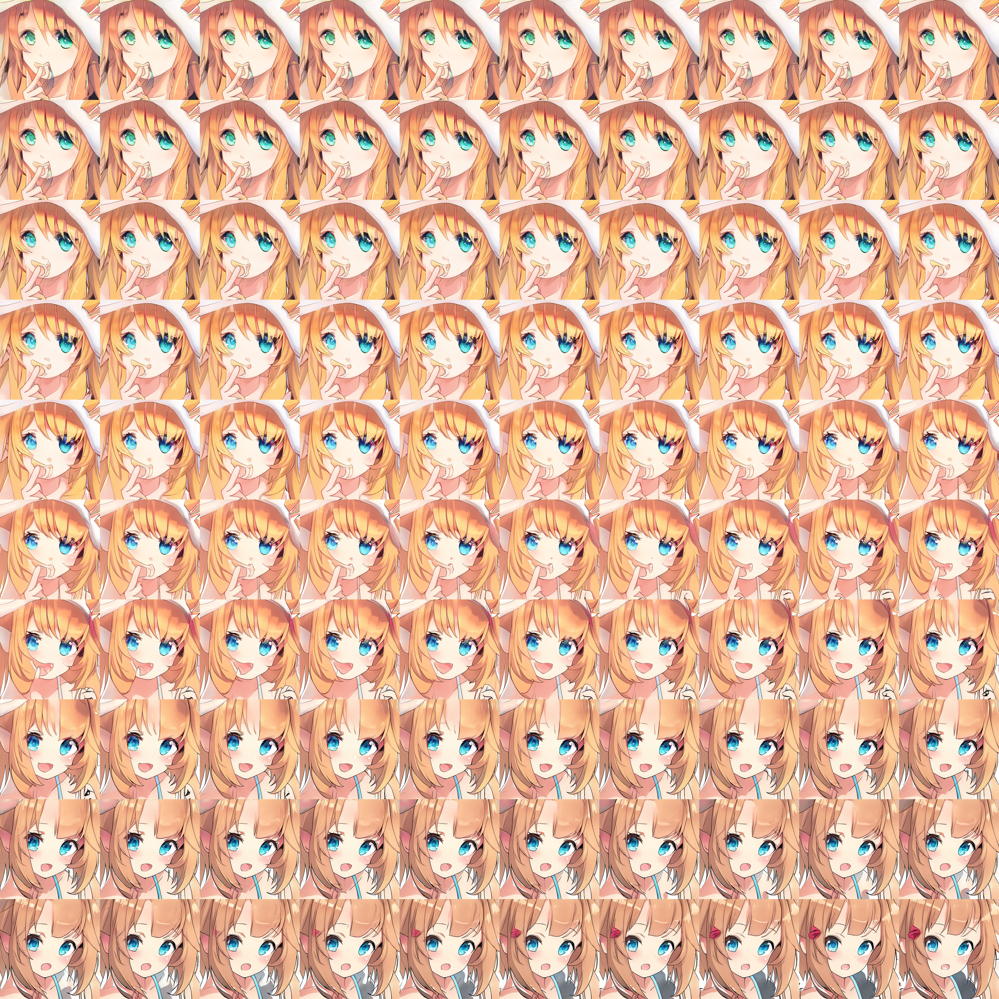

In [ ]:
# Simple (Z) interpolation
zs = generate_zs_from_seeds([5415390 , 8248078 ])

latent1 = zs[0]
latent2 = zs[1]

number_of_steps = 100

imgs = generate_images(interpolate([latent1,latent2],number_of_steps), 1.2)
number_of_images = len(imgs)
imshow(createImageGrid(imgs, 0.7 , 10))

In [ ]:
# generate some random seeds
l = [np.round(i,1) for i in np.linspace(0.2,1,9)]
seeds = np.random.randint(10000000, size=50)
print(seeds)
for i in l:
  print("Generating image for trucation-psi{}".format(i))
  imshow(createImageGrid(generate_images_from_seeds(seeds, i), 0.4 , 5))

In [ ]:
# generate some random seeds
l = [np.round(i,1) for i in np.linspace(0.2,1,13)]
seeds = [50400000,51400000,52400000,53400000,54400000,55400000]
for i in l:
  print("Generating image for trucation-psi{}".format(i))
  imshow(createImageGrid(generate_images_from_seeds(seeds, i), 0.4 , 1))

In [ ]:
# generating a MP4 movie

%mkdir out
zs = generate_zs_from_seeds([431742,656779,3280614,3900800 ,3800000,5260659,3730603])

number_of_steps = 100
l = [np.round(i,1) for i in np.linspace(0.2,1,9)]
for i in l:
  print("Generating interpolation for truncation psi{}".format(i))
  imgs = generate_images(interpolate(zs,number_of_steps), i)

# Example of reading a generated set of images, and storing as MP4.
  movieName = f'out/mov{i}.mp4'
  with imageio.get_writer(movieName, mode='I') as writer:
      for image in log_progress(list(imgs), name = "Creating animation"):
          writer.append_data(np.array(image))

mkdir: cannot create directory ‘out’: File exists
Generating interpolation for truncation psi0.2


Generating interpolation for truncation psi0.3


Generating interpolation for truncation psi0.4


Generating interpolation for truncation psi0.5


Generating interpolation for truncation psi0.6


Generating interpolation for truncation psi0.7


Generating interpolation for truncation psi0.8


Generating interpolation for truncation psi0.9


Generating interpolation for truncation psi1.0


In [ ]:
# more complex example, interpolating in W instead of Z space.
zs = generate_zs_from_seeds([9909645,92149575,99487643,99766864 ,99457159,99210657,9970613 ])

# It seems my truncation_psi is slightly less efficient in W space - I probably introduced an error somewhere...

dls = []
for z in zs:
  dls.append(convertZtoW(z ,truncation_psi=1.0))

number_of_steps = 100

imgs = generate_images_in_w_space(interpolate(dls,number_of_steps), 0.7)

%mkdir out
movieName = 'out/mov.mp4'

with imageio.get_writer(movieName, mode='I') as writer:
    for image in log_progress(list(imgs), name = "Creating animation"):
        writer.append_data(np.array(image))

mkdir: cannot create directory ‘out’: File exists
